<a href="https://colab.research.google.com/github/miriam-mendez/ADM/blob/main/colorizer.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import os
import time
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import tensorflow_datasets as tfds
import pathlib
import time
import datetime

from PIL import Image
from tqdm import tqdm
from tensorflow import keras
from IPython.display import clear_output, display

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
PATH_TEST = "/content/drive/MyDrive/Colab Notebooks/GAN/data/test/"
PATH_DEVEL = "/content/drive/MyDrive/Colab Notebooks/GAN/data/validation/"
PATH_TRAIN = "/content/drive/MyDrive/Colab Notebooks/GAN/data/train/"
PATH_GENERATOR = "/content/drive/MyDrive/Colab Notebooks/GAN/generator/"

In [4]:
# The facade training set consist of 400 images
BUFFER_SIZE = 500
# The batch size of 1 produced better results for the U-Net in the original pix2pix experiment
BATCH_SIZE = 1
# Each image is 256x256 in size
IMG_WIDTH = 256
IMG_HEIGHT = 256

# Loading the data

In [5]:
def load(image_file):
  image = tf.io.read_file(image_file)
  image = tf.image.decode_jpeg(image)

  w = tf.shape(image)[1]

  w = w // 2
  input_image = image[:, :w, :]
  real_image = image[:, w:, :]

  input_image = tf.cast(input_image, tf.float32)
  real_image = tf.cast(real_image, tf.float32)

  return input_image, real_image

Text(0.5, 1.0, 'real image')

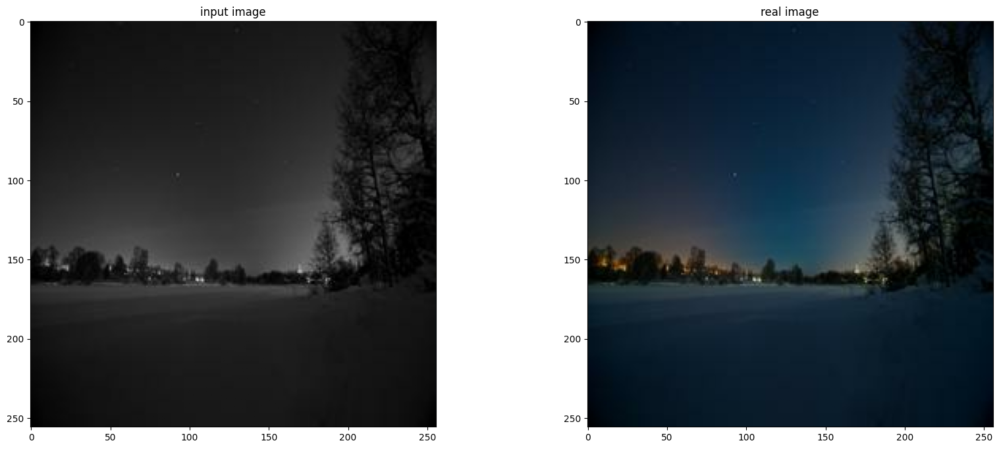

In [6]:
inp, re = load(PATH_TRAIN + '00000001.jpg')

fig, (ax1,ax2) = plt.subplots(1,2,figsize=(20,8))
ax1.imshow(inp/255.0)
ax1.set_title('input image')
ax2.imshow(re/255.0)
ax2.set_title('real image')

# Pre-processing the data
* normalize to [-1, 1]
* resize to IMG_HEIGHT and IMG_WIDTH
* random cut
* random jitter (*random jitter*):
   * In this process, as mentioned in the paper, the image is resized to a larger size, then a random cut of the original size is made and then a horizontal flip is also made randomly. Below are 4 examples.

In [7]:
def resize(input_image, real_image, height, width):
  input_image = tf.image.resize(input_image, [height, width],
                                method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  real_image = tf.image.resize(real_image, [height, width],
                               method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)

  return input_image, real_image

In [8]:
def random_crop(input_image, real_image):
  stacked_image = tf.stack([input_image, real_image], axis=0)
  cropped_image = tf.image.random_crop(
      stacked_image, size=[2, IMG_HEIGHT, IMG_WIDTH, 3])

  return cropped_image[0], cropped_image[1]

In [9]:
# normalizing the images to [-1, 1]
def normalize(input_image, real_image):
  input_image = (input_image / 127.5) - 1
  real_image = (real_image / 127.5) - 1

  return input_image, real_image

In [10]:
@tf.function()
def random_jitter(input_image, real_image):
  # resizing to 286 x 286 x 3
  input_image, real_image = resize(input_image, real_image, 286, 286)

  # randomly cropping to 256 x 256 x 3
  input_image, real_image = random_crop(input_image, real_image)

  if tf.random.uniform(()) > 0.5:
    # random mirroring
    input_image = tf.image.flip_left_right(input_image)
    real_image = tf.image.flip_left_right(real_image)

  return input_image, real_image

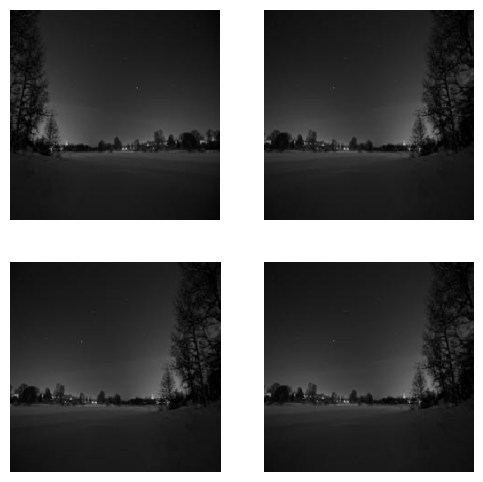

In [11]:
plt.figure(figsize=(6, 6))
for i in range(4):
  rj_inp, rj_re = random_jitter(inp, re)
  plt.subplot(2, 2, i+1)
  plt.imshow(rj_inp/255.0)
  plt.axis('off')
plt.show()

In [12]:
def load_image_train(image_file):
  input_image, real_image = load(image_file)
  input_image, real_image = random_jitter(input_image, real_image)
  input_image, real_image = normalize(input_image, real_image)

  return input_image, real_image

In [13]:
def load_image_test(image_file):
  input_image, real_image = load(image_file)
  input_image, real_image = resize(input_image, real_image, IMG_HEIGHT, IMG_WIDTH)
  input_image, real_image = normalize(input_image, real_image)

  return input_image, real_image

In [14]:
train_dataset = tf.data.Dataset.list_files(PATH_TRAIN+'*.jpg')
train_dataset = train_dataset.map(load_image_train, num_parallel_calls=tf.data.AUTOTUNE)
train_dataset = train_dataset.shuffle(BUFFER_SIZE)
train_dataset = train_dataset.batch(BATCH_SIZE)

In [15]:
val_dataset = tf.data.Dataset.list_files(PATH_DEVEL+'*.jpg')
val_dataset = val_dataset.map(load_image_test)
val_dataset = val_dataset.batch(BATCH_SIZE)


In [16]:
test_dataset = tf.data.Dataset.list_files(PATH_DEVEL+'*.jpg')
test_dataset = test_dataset.map(load_image_test)
test_dataset = test_dataset.batch(BATCH_SIZE)

## Building the generator

In [17]:
OUTPUT_CHANNELS = 3

Define the downsample (encoder)

In [18]:
def downsample(filters, size, apply_batchnorm=True):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, use_bias=False))

  if apply_batchnorm:
    result.add(tf.keras.layers.BatchNormalization())

  result.add(tf.keras.layers.LeakyReLU())

  return result

In [19]:
# downsampling
down_model = downsample(3, 4)
down_result = down_model(tf.expand_dims(inp, 0))
print (down_result.shape)

(1, 128, 128, 3)


Define the upsampler (decode)

In [20]:
def upsample(filters, size, apply_dropout=False):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
    tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                    padding='same',
                                    kernel_initializer=initializer,
                                    use_bias=False))

  result.add(tf.keras.layers.BatchNormalization())

  if apply_dropout:
      result.add(tf.keras.layers.Dropout(0.5))

  result.add(tf.keras.layers.ReLU())

  return result

In [21]:
# upsampling
up_model = upsample(3, 4)
up_result = up_model(down_result)
print (up_result.shape)

(1, 256, 256, 3)


Define the generator with the downsampler and the upsampler

In [22]:
def Generator():
  down_stack = [
    downsample(64, 4, apply_batchnorm=False), # (batch_size, 128, 128, 64)
    downsample(128, 4), # (batch_size, 64, 64, 128)
    downsample(256, 4), # (batch_size, 32, 32, 256)
    downsample(512, 4), # (batch_size, 16, 16, 512)
    downsample(512, 4), # (batch_size, 8, 8, 512)
    downsample(512, 4), # (batch_size, 4, 4, 512)
    downsample(512, 4), # (batch_size, 2, 2, 512)
    downsample(512, 4), # (batch_size, 1, 1, 512)
  ]

  up_stack = [
    upsample(512, 4, apply_dropout=True), # (batch_size, 2, 2, 1024)
    upsample(512, 4, apply_dropout=True), # (batch_size, 4, 4, 1024)
    upsample(512, 4, apply_dropout=True), # (batch_size, 8, 8, 1024)
    upsample(512, 4), # (batch_size, 16, 16, 1024)
    upsample(256, 4), # (batch_size, 32, 32, 512)
    upsample(128, 4), # (batch_size, 64, 64, 256)
    upsample(64, 4), # (batch_size, 128, 128, 128)
  ]

  initializer = tf.random_normal_initializer(0., 0.02)
  last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
                                         strides=2,
                                         padding='same',
                                         kernel_initializer=initializer,
                                         activation='tanh') # (bs, 256, 256, 3)

  concat = tf.keras.layers.Concatenate()

  inputs = tf.keras.layers.Input(shape=[None,None,3])
  x = inputs

  # Downsampling through the model
  skips = []
  for down in down_stack:
    x = down(x)
    skips.append(x)

  skips = reversed(skips[:-1])

  # Upsampling and establishing the skip connections
  for up, skip in zip(up_stack, skips):
    x = up(x)
    x = concat([x, skip])

  x = last(x)

  return tf.keras.Model(inputs=inputs, outputs=x)

Visualize the generator model architecture

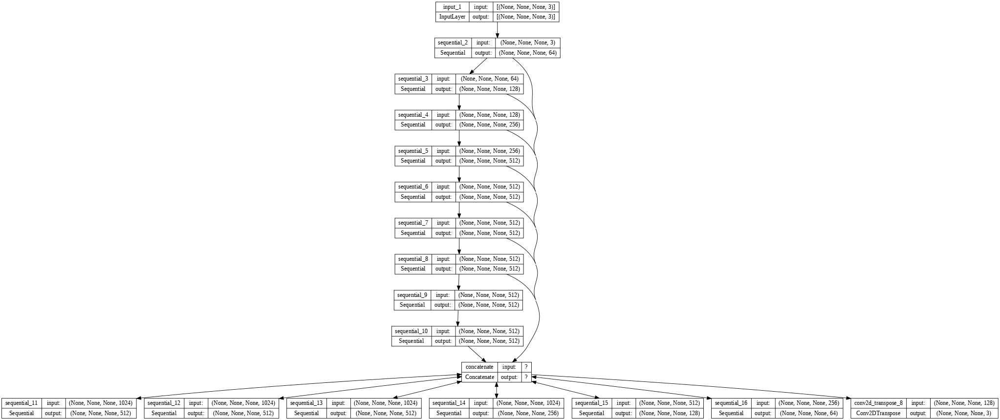

In [23]:
generator = Generator()
tf.keras.utils.plot_model(generator, show_shapes=True, dpi=64)

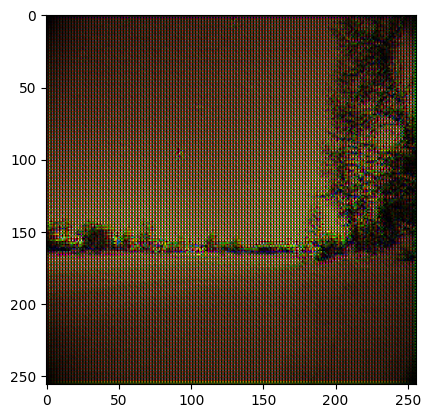

In [24]:

gen_output = generator(inp[tf.newaxis,...], training=False)
plt.imshow(gen_output[0,...])

In [25]:
LAMBDA = 100
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)
def generator_loss(disc_generated_output, gen_output, target):
  gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

  # Mean absolute error
  l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

  total_gen_loss = gan_loss + (LAMBDA * l1_loss)

  return total_gen_loss, gan_loss, l1_loss


SyntaxError: ignored

# Discriminator

In [26]:
def Discriminator():
  initializer = tf.random_normal_initializer(0., 0.02)

  inp = tf.keras.layers.Input(shape=[None, None, 3], name='input_image')
  tar = tf.keras.layers.Input(shape=[None, None, 3], name='target_image')

  x = tf.keras.layers.concatenate([inp, tar]) # (batch_size, 256, 256, channels*2)

  down1 = downsample(64, 4, False)(x) # (batch_size, 128, 128, 64)
  down2 = downsample(128, 4)(down1) # (batch_size, 64, 64, 128)
  down3 = downsample(256, 4)(down2) # (batch_size, 32, 32, 256)

  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3) # (batch_size, 34, 34, 256)
  conv = tf.keras.layers.Conv2D(512, 4, strides=1,
                                kernel_initializer=initializer,
                                use_bias=False)(zero_pad1) # (batch_size, 31, 31, 512)

  batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

  leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu) # (batch_size, 33, 33, 512)

  last = tf.keras.layers.Conv2D(1, 4, strides=1,
                                kernel_initializer=initializer)(zero_pad2) # (batch_size, 30, 30, 1)

  return tf.keras.Model(inputs=[inp, tar], outputs=last)

In [104]:
def create_gan(generator, discriminator):
    discriminator.trainable = False
    inp = tf.keras.layers.Input(shape=[None, None, 3], name='input_image')
    tar = tf.keras.layers.Input(shape=[None, None, 3], name='target_image')
    generator_output = generator(inp)
    gan_output = discriminator((inp, tar))

    gan = tf.keras.Model(inputs=(inp, tar), outputs=gan_output)
    gan.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.Adam(lr=0.0002, beta_1=0.5))

    gan.summary()
    discriminator.trainable = True
    return gan

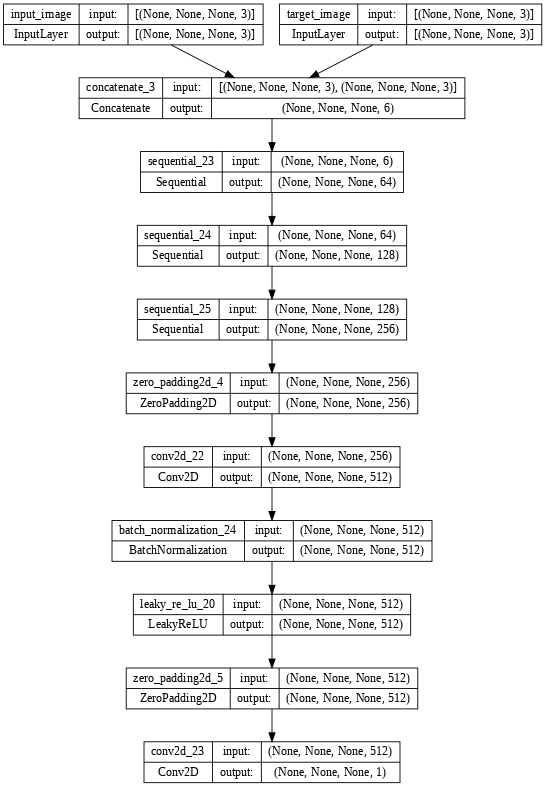

In [106]:
discriminator = Discriminator()
tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi=64)

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_image (InputLayer)       [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 target_image (InputLayer)      [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 model_2 (Functional)           (None, None, None,   2770433     ['input_image[0][0]',            
                                1)                                'target_image[0][0]']     

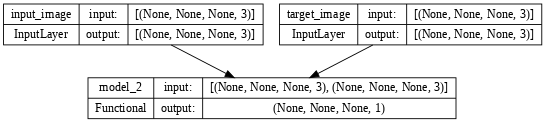

In [105]:
gan = create_gan(generator, discriminator)
tf.keras.utils.plot_model(gan, show_shapes=True, dpi=64)

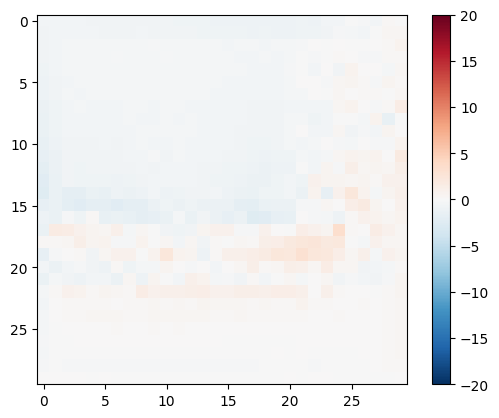

In [28]:

disc_out = discriminator([inp[tf.newaxis,...], gen_output], training=False)
plt.imshow(disc_out[0,...,-1], vmin=-20, vmax=20, cmap='RdBu_r')
plt.colorbar()

In [29]:
def discriminator_loss(disc_real_output, disc_generated_output):
  real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

  generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)

  total_disc_loss = real_loss + generated_loss

  return total_disc_loss


## Define the optimizers and checkpoint-saver

In [30]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [31]:
checkpoint_dir = '/content/drive/MyDrive/Colab Notebooks/GAN/training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)


# Checkpoints

In [32]:
EPOCHS = 6

In [33]:
def generate_images(model, test_input, tar):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15,15))

  display_list = [test_input[0], tar[0], prediction[0]]
  title = ['Input Image', 'Ground Truth', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    # getting the pixel values between [0, 1] to plot it.
    plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.axis('off')
  plt.show()

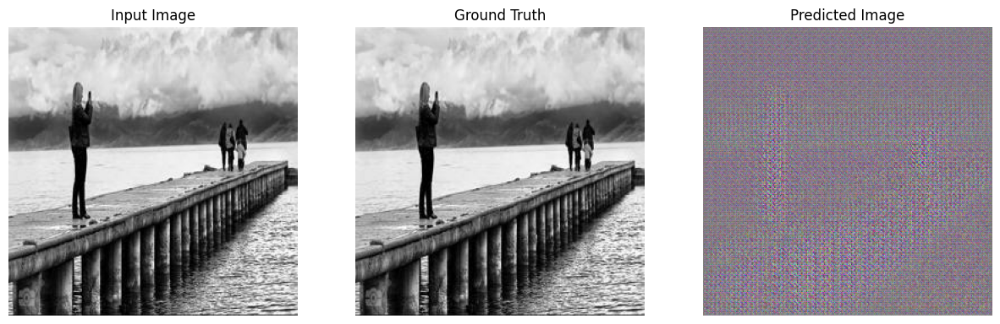

In [34]:
for example_input, example_target in test_dataset.take(1):
  generate_images(generator, example_input, example_target)


# Training

In [35]:
log_dir="/content/drive/MyDrive/Colab Notebooks/GAN/logs/"

summary_writer = tf.summary.create_file_writer(
  log_dir + "fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))


In [36]:
@tf.function
def train_step(input_image, target, epoch):
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    gen_output = generator(input_image, training=True)

    disc_real_output = discriminator([input_image, target], training=True)
    disc_generated_output = discriminator([input_image, gen_output], training=True)

    gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
    disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

  generator_gradients = gen_tape.gradient(gen_total_loss,
                                          generator.trainable_variables)
  discriminator_gradients = disc_tape.gradient(disc_loss,
                                               discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(generator_gradients,
                                          generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(discriminator_gradients,
                                              discriminator.trainable_variables))

  with summary_writer.as_default():
    tf.summary.scalar('gen_total_loss', gen_total_loss, step=epoch)
    tf.summary.scalar('gen_gan_loss', gen_gan_loss, step=epoch)
    tf.summary.scalar('gen_l1_loss', gen_l1_loss, step=epoch)
    tf.summary.scalar('disc_loss', disc_loss, step=epoch)


In [37]:
def train(train_dataset, val_dataset, epochs):
  
  for epoch in range(epochs):
    start = time.time()

    for input_image, target in tqdm(train_dataset):
      train_step(input_image, target, epoch)
      # checkpoint.save(file_prefix = checkpoint_prefix)
      

    for inp, tar in val_dataset.take(10):
        generate_images(generator, inp, tar)
        clear_output(wait=True)

    print ('Time taken for epoch {} is {} sec\n'.format(epoch + 1, time.time()-start))

In [38]:
train(train_dataset, val_dataset, EPOCHS)

Time taken for epoch 6 is 334.1323437690735 sec



In [52]:
if not os.path.exists(PATH_GENERATOR):
  os.makedirs(PATH_GENERATOR)
generator.save(PATH_GENERATOR+'generator_final.h5')

In [53]:
if not os.path.exists(PATH_GENERATOR):
  os.makedirs(PATH_GENERATOR)
discriminator.save(PATH_GENERATOR+'discriminator_final.h5')

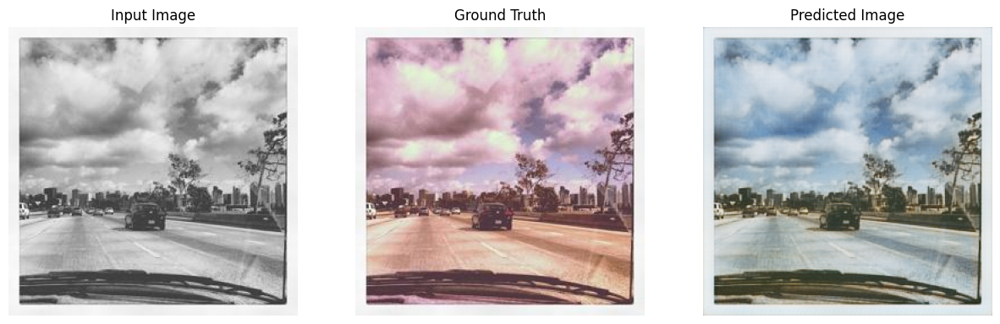

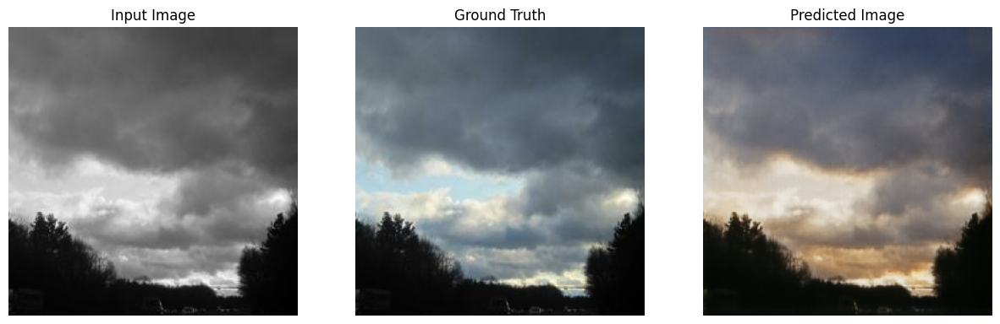

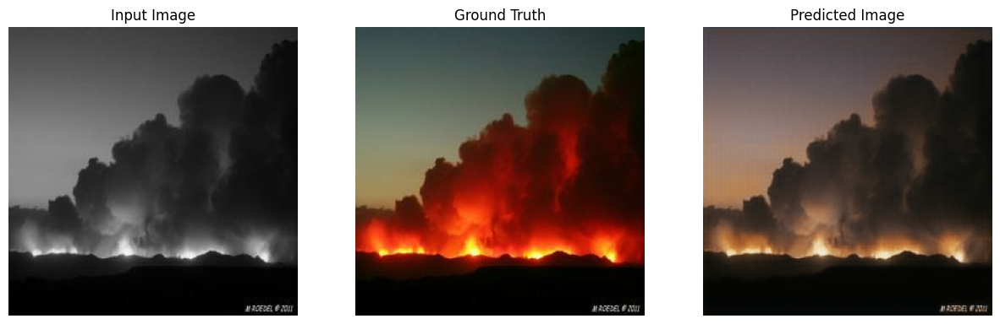

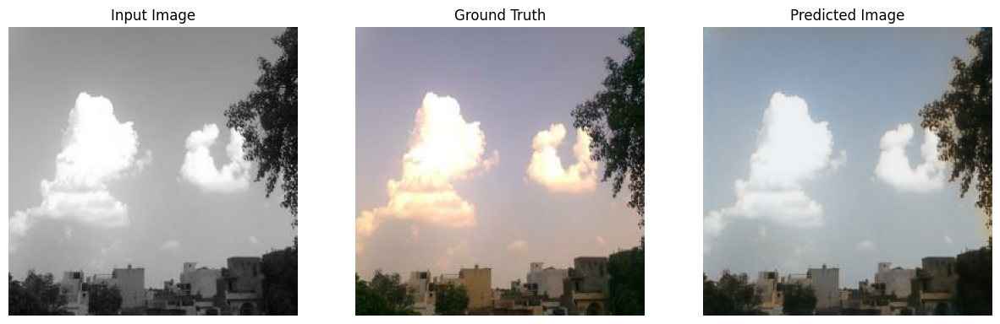

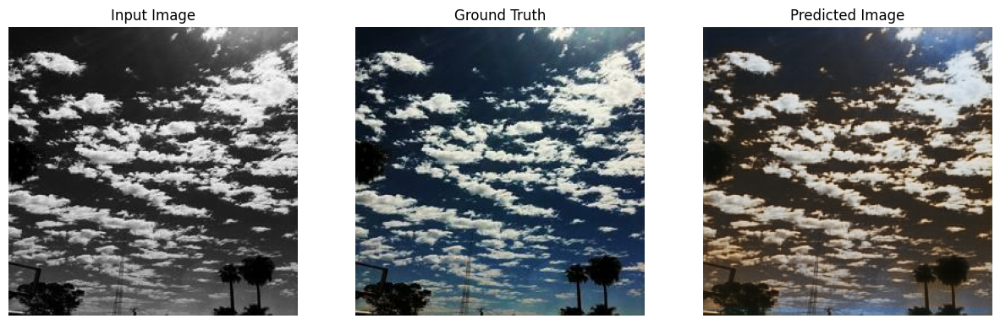

...

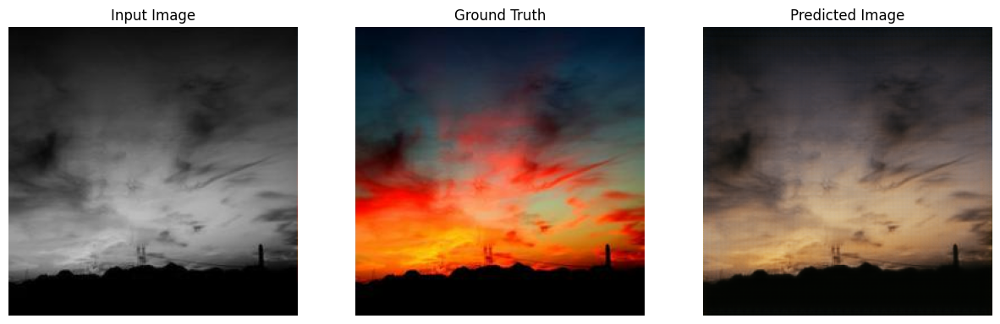

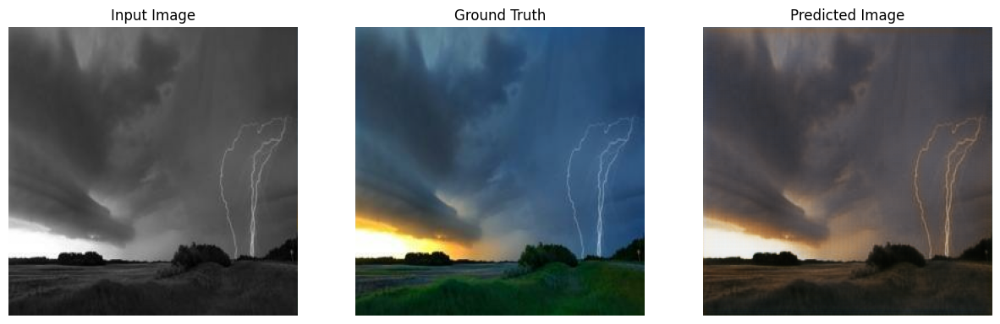

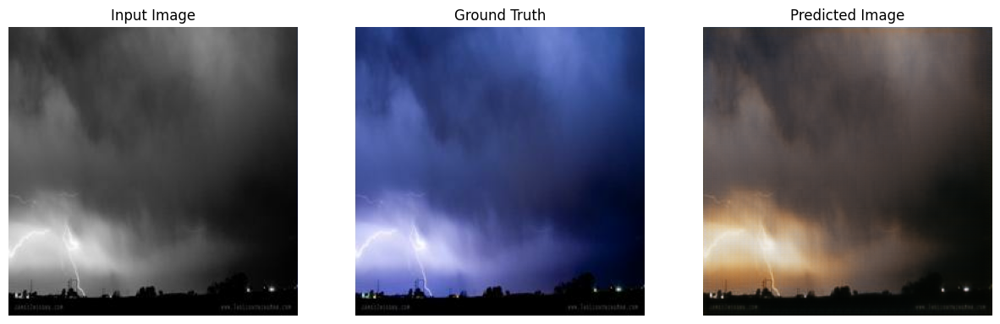

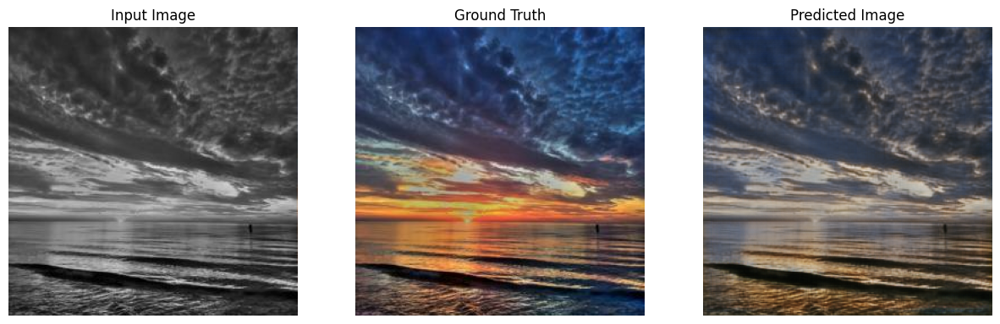

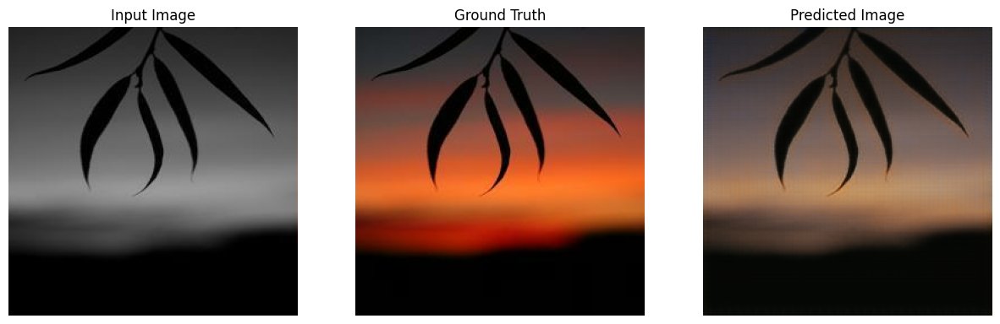

In [40]:
for inp, tar in test_dataset.take(50):
  generate_images(generator, inp, tar)

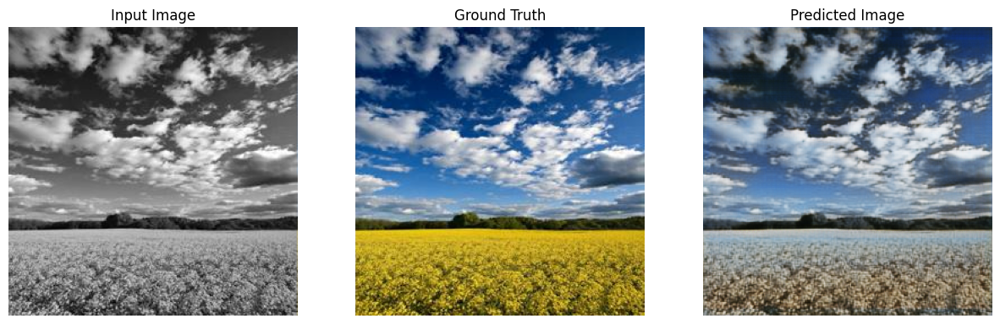

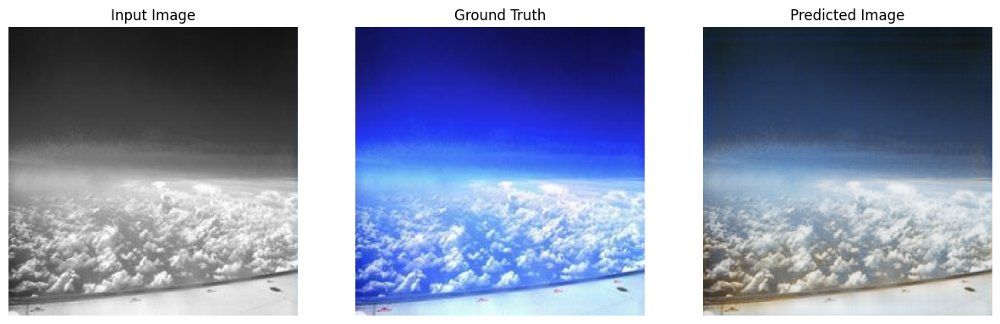

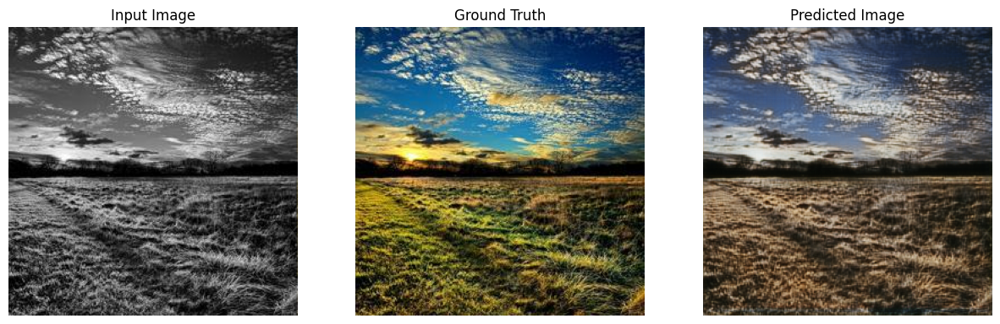

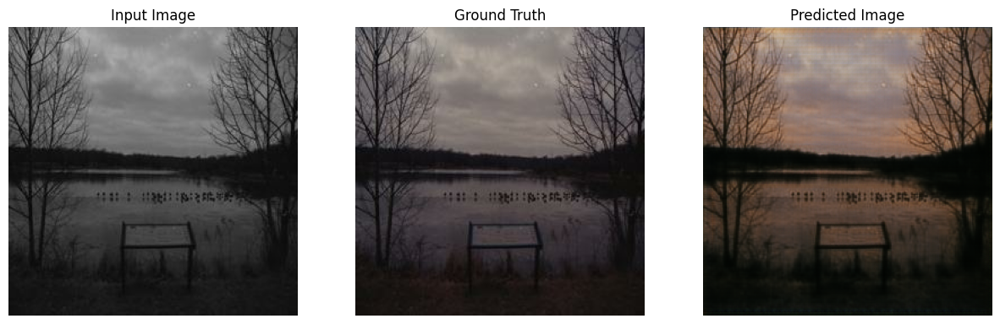

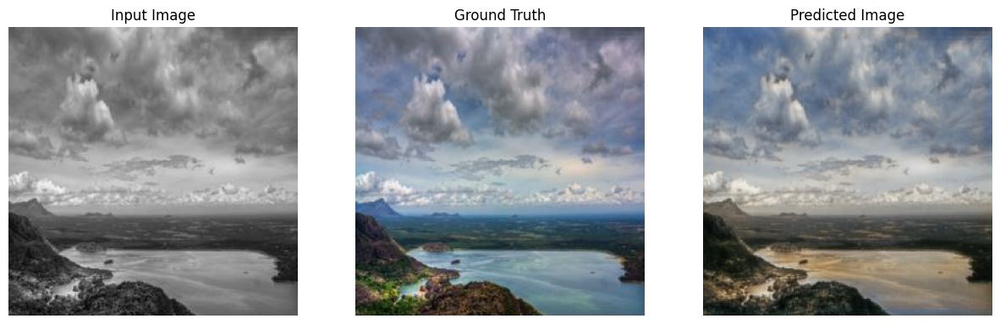

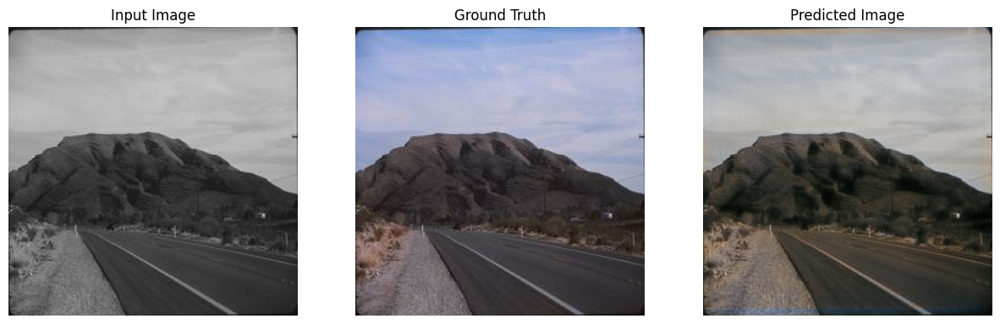

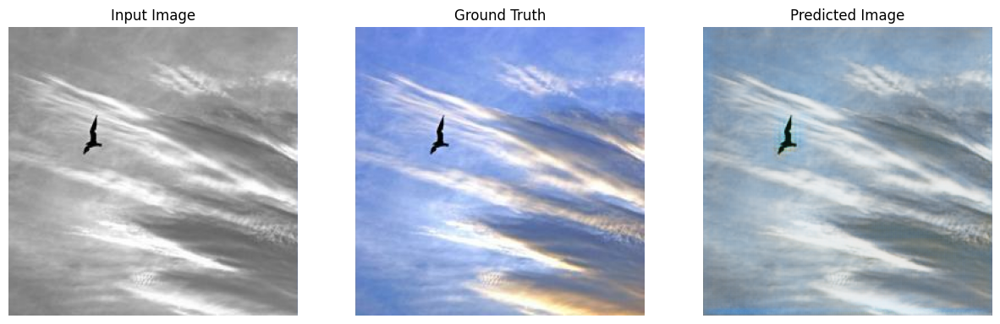

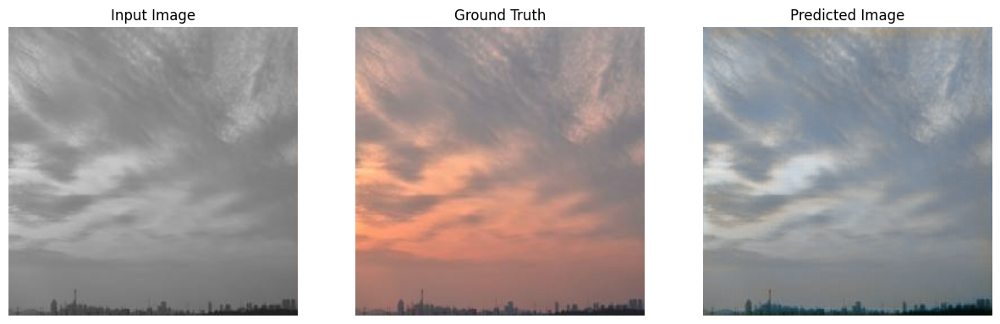

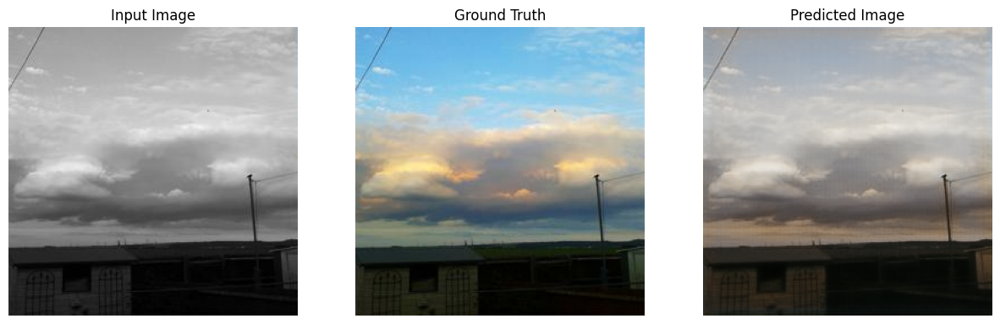

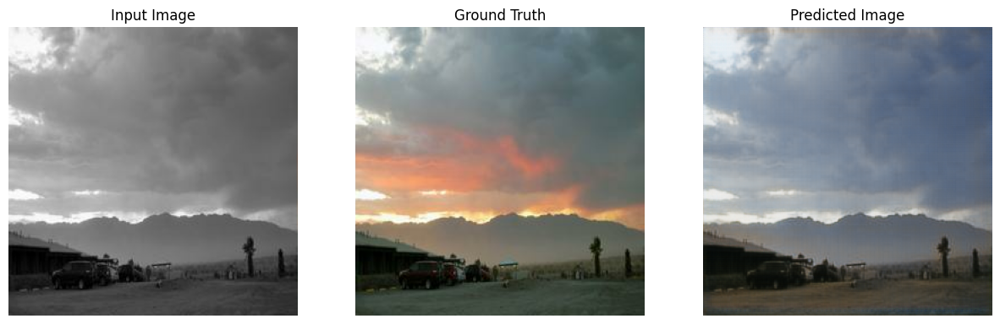

In [83]:
new_model = keras.models.load_model(PATH_GENERATOR+'final.h5')

for inp, tar in test_dataset.take(10):
  generate_images(new_model, inp, tar)

TypeError: ignored

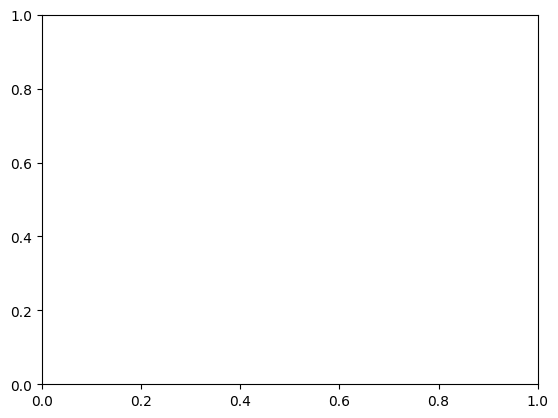

In [90]:
plt.plot(generator_loss)

In [91]:
discriminator.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_image (InputLayer)       [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 target_image (InputLayer)      [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 concatenate_1 (Concatenate)    (None, None, None,   0           ['input_image[0][0]',            
                                6)                                'target_image[0][0]']     

In [95]:
def create_gan(generator, discriminator):
    discriminator.trainable = False

    gan_input = tf.keras.layers.Input(shape=[256,256,3])
    generator_output = generator(gan_input)
    gan_output = discriminator(generator_output)

    gan = tf.keras.Model(inputs=gan_input, outputs=gan_output)
    gan.compile(loss='binary_crossentropy', optimizer=Adam(lr=0.0002, beta_1=0.5))

    gan.summary()
    discriminator.trainable = True
    return gan

In [119]:
def save(gan, generator, discriminator):
    discriminator.trainable = False
    gan.save('gan.h5')
    discriminator.trainable = True
    generator.save('generator.h5')
    discriminator.save('discriminator.h5')


def load():
    discriminator = keras.models.load_model('discriminator.h5')
    generator = keras.models.load_model('generator.h5')
    gan = keras.models.load_model('gan.h5')
    gan.summary()
    discriminator.summary()
    generator.summary()

    return gan, generator, discriminator

In [113]:
save(gan,generator,discriminator)

In [120]:
new_gan, new_generator, new_discriminator = load()

/usr/local/lib/python3.10/dist-packages/keras/initializers/initializers.py:120: UserWarning: The initializer RandomNormal is unseeded and being called multiple times, which will return identical values each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initalizer instance more than once.
  warnings.warn(


Model: "model_5"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_image (InputLayer)       [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 target_image (InputLayer)      [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 model_4 (Functional)           (None, None, None,   2770433     ['input_image[0][0]',            
                                1)                                'target_image[0][0]']     